In [1]:
!pip install -q pycocotools albumentations pytorch-lightning

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 815.2/815.2 kB 17.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 926.4/926.4 kB 23.1 MB/s eta 0:00:00


The code for this notebook is based on this repository: https://github.com/NielsRogge/Transformers-Tutorials/blob/master/DETR/Fine_tuning_DetrForObjectDetection_on_custom_dataset_(balloon).ipynb

**Run this code with Colab GPU T4!**

In [2]:
import torch
import numpy as np
import random
import os
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import json
from sklearn.model_selection import train_test_split
import albumentations as A
import torchvision
from torch.utils.data import DataLoader, Dataset
from transformers import DetrForObjectDetection, DetrImageProcessor
import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint
from pytorch_lightning.loggers import TensorBoardLogger
from pycocotools.coco import COCO

# Set random seeds for reproducibility
torch.manual_seed(42)
np.random.seed(42)
random.seed(42)


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.21 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [3]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("vbookshelf/v2-balloon-detection-dataset")

print("Path to dataset files:", path)

100%|██████████| 47.5M/47.5M [00:00<00:00, 117MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/vbookshelf/v2-balloon-detection-dataset/versions/13


In [4]:
df = pd.read_csv('/root/.cache/kagglehub/datasets/vbookshelf/v2-balloon-detection-dataset/versions/13/balloon-data.csv')
df

,fname,height,width,bbox,num_balloons
0,34020010494_e5cb88e1c4_k.jpg,1536,2048,"[{'xmin': 994, 'ymin': 619, 'xmax': 1445, 'yma...",1
1,25899693952_7c8b8b9edc_k.jpg,1365,2048,"[{'xmin': 135, 'ymin': 115, 'xmax': 811, 'ymax...",1
2,24362039530_b151b41a52_k.jpg,2048,1536,"[{'xmin': 579, 'ymin': 487, 'xmax': 920, 'ymax...",1
3,18849792632_aad23ad513_k.jpg,2048,1536,"[{'xmin': 534, 'ymin': 365, 'xmax': 871, 'ymax...",10
4,17178818589_16e58fc1e5_k.jpg,1536,2048,"[{'xmin': 748, 'ymin': 195, 'xmax': 1425, 'yma...",7
...,...,...,...,...,...
69,4581425993_72b9b15fc0_b.jpg,1024,776,"[{'xmin': 345, 'ymin': 16, 'xmax': 486, 'ymax'...",1
70,3825919971_93fb1ec581_b.jpg,1024,683,"[{'xmin': 206, 'ymin': 153, 'xmax': 347, 'ymax...",6
71,3800636873_ace2c2795f_b.jpg,1024,686,"[{'xmin': 337, 'ymin': 84, 'xmax': 498, 'ymax'...",1
72,2917282960_06beee649a_b.jpg,681,1024,"[{'xmin': 474, 'ymin': 248, 'xmax': 595, 'ymax...",1


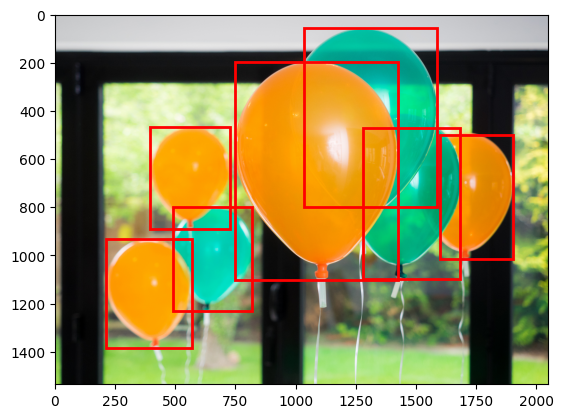

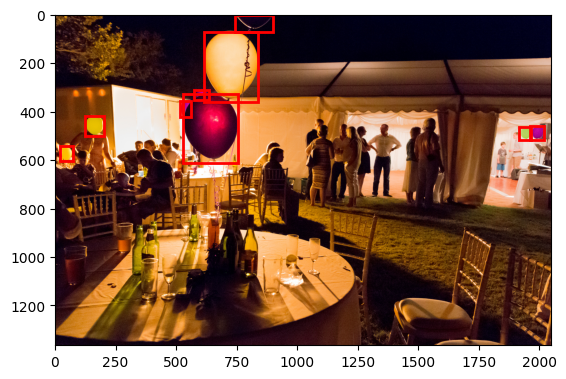

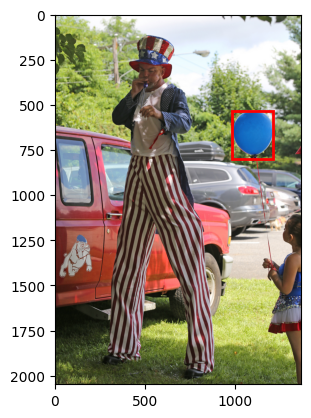

In [6]:
# Load the dataset
df = pd.read_csv('/root/.cache/kagglehub/datasets/vbookshelf/v2-balloon-detection-dataset/versions/13/balloon-data.csv')

# Path to images
images_path = '/root/.cache/kagglehub/datasets/vbookshelf/v2-balloon-detection-dataset/versions/13/images'

# Display a few examples
selected_rows = df.sample(n=3, random_state=42)

# Plot images with bounding boxes
for _, row in selected_rows.iterrows():
    img_path = os.path.join(images_path, row['fname'])
    img = Image.open(img_path)
    bboxes = eval(row['bbox'])  # Convert bbox string to Python object

    fig, ax = plt.subplots(1)
    ax.imshow(img)

    # Draw each bounding box
    for bbox in bboxes:
        rect = patches.Rectangle(
            (bbox['xmin'], bbox['ymin']),
            bbox['xmax'] - bbox['xmin'],
            bbox['ymax'] - bbox['ymin'],
            linewidth=2,
            edgecolor='r',
            facecolor='none'
        )
        ax.add_patch(rect)

    plt.show()


In [7]:
# Get unique image filenames
image_filenames = df['fname'].unique()

# Split into training and temporary sets
train_filenames, temp_filenames = train_test_split(
    image_filenames, test_size=0.3, random_state=42)

# Further split the temporary set into validation and test sets
val_filenames, test_filenames = train_test_split(
    temp_filenames, test_size=0.5, random_state=42)

print(f"Total images: {len(image_filenames)}")
print(f"Training images: {len(train_filenames)}")
print(f"Validation images: {len(val_filenames)}")
print(f"Testing images: {len(test_filenames)}")


Total images: 74
Training images: 51
Validation images: 11
Testing images: 12


We need to convert the annotations to COCO format to use CocoDetection.

In [10]:
import os
import json
import datetime
from PIL import Image
from sklearn.model_selection import train_test_split

def save_annotations_to_coco(
    df,
    imgdir,
    train_filenames,
    val_filenames,
    test_filenames,
    output_paths
):
    def ensure_directory_exists(filepath):
        """Ensure the directory for the given filepath exists."""
        directory = os.path.dirname(filepath)
        if not os.path.exists(directory):
            os.makedirs(directory)

    def convert_to_coco_format(image_filenames, annotations_df, output_file_name):
        coco_output = {
            "info": {
                "description": "Example Dataset",
                "url": "https://github.com/waspinator/pycococreator",
                "version": "0.1.0",
                "year": 2024,
                "contributor": "user",
                "date_created": datetime.datetime.now().isoformat(),
            },
            "licenses": [
                {
                    "id": 1,
                    "name": "Attribution-NonCommercial-ShareAlike License",
                    "url": "http://creativecommons.org/licenses/by-nc-sa/2.0/",
                }
            ],
            "categories": [
                {
                    "id": 1,
                    "name": "balloon",
                    "supercategory": "object",
                }
            ],
            "images": [],
            "annotations": []
        }
        ann_id = 0

        for img_id, filename in enumerate(image_filenames):
            img_data = annotations_df[annotations_df['fname'] == filename].iloc[0]
            img = Image.open(os.path.join(imgdir, filename))
            image_info = {
                "id": int(img_id),  # Ensure JSON-serializable types
                "file_name": os.path.basename(filename),
                "width": int(img_data['width']),  # Convert to int
                "height": int(img_data['height']),  # Convert to int
            }
            coco_output["images"].append(image_info)

            # Add annotations for this image
            for bbox in json.loads(img_data['bbox'].replace("'", '"')):
                xmin = int(bbox['xmin'])  # Convert to int
                ymin = int(bbox['ymin'])  # Convert to int
                xmax = int(bbox['xmax'])  # Convert to int
                ymax = int(bbox['ymax'])  # Convert to int
                width = xmax - xmin
                height = ymax - ymin
                area = width * height
                annotation = {
                    "id": int(ann_id),  # Convert to int
                    "image_id": int(img_id),  # Convert to int
                    "category_id": 1,
                    "iscrowd": 0,
                    "area": float(area),  # Convert to float for JSON compatibility
                    "bbox": [xmin, ymin, width, height],
                }
                coco_output["annotations"].append(annotation)
                ann_id += 1

        # Ensure directory exists before saving
        ensure_directory_exists(output_file_name)

        # Save to file
        with open(output_file_name, "w") as f:
            json.dump(coco_output, f)
        print(f"Annotations saved to {output_file_name}")

    # Generate and save annotations for each split
    for split, filenames, output_file in zip(
        ['train', 'val', 'test'],
        [train_filenames, val_filenames, test_filenames],
        output_paths
    ):
        print(f"Processing {split} split...")
        convert_to_coco_format(filenames, df, output_file)

# Paths to annotation files
output_paths = [
    "annotations/train.json",
    "annotations/val.json",
    "annotations/test.json"
]

# Creating COCO annotations
save_annotations_to_coco(df, images_path, train_filenames, val_filenames, test_filenames, output_paths)

Processing train split...
Annotations saved to annotations/train.json
Processing val split...
Annotations saved to annotations/val.json
Processing test split...
Annotations saved to annotations/test.json


In [11]:
from pycocotools.coco import COCO

coco = COCO("annotations/train.json")

print("Images:", len(coco.imgs))
print("Annotations:", len(coco.anns))
print("Categories:", len(coco.cats))

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Images: 51
Annotations: 205
Categories: 1


In [12]:
# Define the augmentation pipeline for training
train_transforms = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.Perspective(scale=(0.05, 0.1), p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.Resize(800, 800),
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['class_labels']))


We'll create a custom dataset class that inherits from CocoDetection and applies augmentations.

In [13]:
class CustomCocoDataset(torchvision.datasets.CocoDetection):
    def __init__(self, img_folder, ann_file, transforms=None):
        super().__init__(img_folder, ann_file)
        self.albumentations_transforms = transforms  # Use a different attribute name
        self.ids = list(sorted(self.ids))
        self.coco = COCO(ann_file)
        self.img_folder = img_folder

    def __getitem__(self, idx):
        img_id = self.ids[idx]
        ann_ids = self.coco.getAnnIds(imgIds=img_id)
        annotations = self.coco.loadAnns(ann_ids)
        path = self.coco.loadImgs(img_id)[0]['file_name']
        img = Image.open(os.path.join(self.img_folder, path)).convert('RGB')
        img = np.array(img)

        # Extract bboxes and labels for Albumentations
        bboxes = []
        class_labels = []
        for ann in annotations:
            bbox = ann['bbox']
            xmin, ymin, width, height = bbox
            xmax = xmin + width
            ymax = ymin + height
            bboxes.append([xmin, ymin, xmax, ymax])
            class_labels.append(ann['category_id'])

        # Apply Albumentations transforms
        if self.albumentations_transforms:
            transformed = self.albumentations_transforms(
                image=img, bboxes=bboxes, class_labels=class_labels)
            img = transformed['image']
            bboxes = transformed['bboxes']
            class_labels = transformed['class_labels']

            # Reconstruct annotations in COCO format after augmentation
            annotations = []
            for bbox, label in zip(bboxes, class_labels):
                xmin, ymin, xmax, ymax = bbox
                width = xmax - xmin
                height = ymax - ymin
                annotations.append({
                    'bbox': [xmin, ymin, width, height],
                    'category_id': label,
                    'iscrowd': 0,
                    'area': width * height
                })
        else:
            img = Image.fromarray(img)

        # Prepare the target in the format expected by the processor
        target = {'image_id': img_id, 'annotations': annotations}

        return img, target


In [15]:
processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/290 [00:00<?, ?B/s]

In [16]:
# Paths to image folder and annotations
img_folder = images_path
train_ann_file = 'annotations/train.json'
val_ann_file = 'annotations/val.json'
test_ann_file = 'annotations/test.json'

# Create datasets
train_dataset = CustomCocoDataset(img_folder, train_ann_file, transforms=train_transforms)
val_dataset = CustomCocoDataset(img_folder, val_ann_file)
test_dataset = CustomCocoDataset(img_folder, test_ann_file)

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


In [17]:
# Function to augment the training dataset by a factor of 5
class AugmentedDataset(torch.utils.data.Dataset):
    def __init__(self, dataset, augment_factor):
        self.dataset = dataset
        self.augment_factor = augment_factor
        self.length = len(self.dataset) * augment_factor

    def __len__(self):
        return self.length

    def __getitem__(self, idx):
        original_idx = idx % len(self.dataset)
        return self.dataset[original_idx]

augment_factor = 5
train_dataset_augmented = AugmentedDataset(train_dataset, augment_factor)


In [18]:
def collate_fn(batch):
    images = [item[0] for item in batch]  # images should be PIL Images or numpy arrays
    annotations = [item[1] for item in batch]

    # Process images and annotations using the processor
    encoding = processor(images=images, annotations=annotations, return_tensors="pt", pad_and_return_pixel_mask=True)
    pixel_values = encoding["pixel_values"]
    pixel_mask = encoding["pixel_mask"]
    labels = encoding["labels"]

    # Add original image sizes to labels
    for i in range(len(labels)):
        # If images[i] is a numpy array
        if isinstance(images[i], np.ndarray):
            height, width = images[i].shape[:2]
        # If images[i] is a PIL Image
        elif isinstance(images[i], Image.Image):
            width, height = images[i].size
        else:
            raise TypeError("Unsupported image type")

        labels[i]["orig_size"] = torch.tensor([height, width])

    batch = {
        'pixel_values': pixel_values,
        'pixel_mask': pixel_mask,
        'labels': labels
    }
    return batch


# Data loaders with num_workers=0 for compatibility on Kaggle
train_dataloader = DataLoader(
    train_dataset_augmented,
    batch_size=4,
    shuffle=True,
    collate_fn=collate_fn,
    num_workers=4
)

val_dataloader = DataLoader(
    val_dataset,
    batch_size=2,
    shuffle=False,
    collate_fn=collate_fn,
    num_workers=4
)

test_dataloader = DataLoader(
    test_dataset,
    batch_size=2,
    shuffle=False,
    collate_fn=collate_fn,
    num_workers=4
)



/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


In [19]:
print(f"Original training set size: {len(train_dataset)}")
print(f"Augmented training set size: {len(train_dataset_augmented)}")

Original training set size: 51
Augmented training set size: 255


In [20]:
class DetrModel(pl.LightningModule):
    def __init__(self, lr, lr_backbone, weight_decay):
        super().__init__()
        self.save_hyperparameters()
        self.model = DetrForObjectDetection.from_pretrained(
            "facebook/detr-resnet-50",
            revision="no_timm",
            num_labels=2,
            ignore_mismatched_sizes=True
        )
        self.model.config.id2label = {0: 'N/A', 1: 'balloon'}
        self.model.config.label2id = {'N/A': 0, 'balloon': 1}
        self.lr = lr
        self.lr_backbone = lr_backbone
        self.weight_decay = weight_decay

    def forward(self, pixel_values, pixel_mask=None):
        return self.model(pixel_values=pixel_values, pixel_mask=pixel_mask)

    def common_step(self, batch, batch_idx):
        pixel_values = batch["pixel_values"]
        pixel_mask = batch["pixel_mask"]
        labels = [{k: v.to(self.device) for k, v in t.items()} for t in batch["labels"]]

        outputs = self.model(pixel_values=pixel_values, pixel_mask=pixel_mask, labels=labels)
        return outputs.loss, outputs.loss_dict

    def training_step(self, batch, batch_idx):
        loss, loss_dict = self.common_step(batch, batch_idx)
        self.log("train_loss", loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        for k, v in loss_dict.items():
            self.log(f"train_{k}", v.item(), on_step=True, prog_bar=False)
        return loss

    def validation_step(self, batch, batch_idx):
        loss, loss_dict = self.common_step(batch, batch_idx)
        self.log("val_loss", loss, on_epoch=True, prog_bar=True, logger=True)
        for k, v in loss_dict.items():
            self.log(f"val_{k}", v.item(), on_epoch=True, prog_bar=False)
        return loss

    def configure_optimizers(self):
        param_dicts = [
            {
                "params": [p for n, p in self.model.named_parameters() if "backbone" not in n and p.requires_grad]
            },
            {
                "params": [p for n, p in self.model.named_parameters() if "backbone" in n and p.requires_grad],
                "lr": self.lr_backbone,
            },
        ]
        optimizer = torch.optim.AdamW(param_dicts, lr=self.lr, weight_decay=self.weight_decay)
        lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.1)
        return [optimizer], [lr_scheduler]

    def train_dataloader(self):
        return train_dataloader

    def val_dataloader(self):
        return val_dataloader


In [22]:
# Initialize the model
model = DetrModel(lr=1e-4, lr_backbone=1e-5, weight_decay=1e-4)

# Callbacks for saving the best model
checkpoint_callback = ModelCheckpoint(
    monitor='val_loss',
    dirpath='checkpoints',
    filename='best-checkpoint',
    save_top_k=1,
    mode='min'
)

# Logger for tracking metrics
logger = TensorBoardLogger('lightning_logs', name='detr-balloon')

# Trainer
trainer = pl.Trainer(
    max_epochs=10,
    accelerator='gpu' if torch.cuda.is_available() else 'cpu',
    devices=1 if torch.cuda.is_available() else None,
    callbacks=[checkpoint_callback],
    logger=logger,
    gradient_clip_val=0.1, #0.1
    enable_progress_bar=True,
    log_every_n_steps=1,
    num_sanity_val_steps=0,  # Skip sanity check to avoid potential issues
)

config.json:   0%|          | 0.00/6.60k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/167M [00:00<?, ?B/s]

Some weights of DetrForObjectDetection were not initialized from the model checkpoint at facebook/detr-resnet-50 and are newly initialized because the shapes did not match:
- class_labels_classifier.weight: found shape torch.Size([92, 256]) in the checkpoint and torch.Size([3, 256]) in the model instantiated
- class_labels_classifier.bias: found shape torch.Size([92]) in the checkpoint and torch.Size([3]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [23]:
%load_ext tensorboard
%tensorboard --logdir lightning_logs/

<IPython.core.display.Javascript object>

In [24]:
trainer.fit(model, train_dataloaders=train_dataloader, val_dataloaders=val_dataloader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                   | Params | Mode
--------------------------------------------------------
0 | model | DetrForObjectDetection | 41.5 M | eval
--------------------------------------------------------
18.0 M    Trainable params
23.5 M    Non-trainable params
41.5 M    Total params
166.008   Total estimated model params size (MB)
0         Modules in train mode
467       Modules in eval mode
/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Training: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/albumentations/core/bbox_utils.py:478: RuntimeWarning: invalid value encountered in divide
  & (clipped_box_areas / denormalized_box_areas >= min_visibility - epsilon)
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a f

Validation: |          | 0/? [00:00<?, ?it/s]

The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
/usr/local/lib/python3.10/dist-packages/pytorch_ligh

Validation: |          | 0/? [00:00<?, ?it/s]

The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecat

Validation: |          | 0/? [00:00<?, ?it/s]

The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
/usr/local/lib/python3.10/dist-packages/albumentations/core/bbox_utils.py:478: RuntimeWarning: invalid value encountered in divide
  & (clipped_box_areas / denormalized_box_areas >= min_visibility - epsilon)
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a f

Validation: |          | 0/? [00:00<?, ?it/s]

The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
/usr/local/lib/python3.10/dist-packages/albumentations/core/bbox_utils.py:478: RuntimeWarning: invalid value encountered in divide
  & (clipped_box_areas / denormalized_box_areas >= min_visibility - epsilon)
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a f

Validation: |          | 0/? [00:00<?, ?it/s]

The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
/usr/local/lib/python3.10/dist-packages/albumentations/core/bbox_utils.py:478: RuntimeWarning: invalid value encountered in divide
  & (clipped_box_areas / denormalized_box_areas >= min_visibility - epsilon)
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a f

Validation: |          | 0/? [00:00<?, ?it/s]

The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be r

Validation: |          | 0/? [00:00<?, ?it/s]

The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecat

Validation: |          | 0/? [00:00<?, ?it/s]

The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
/usr/local/lib/python3.10/dist-packages/albumentatio

Validation: |          | 0/? [00:00<?, ?it/s]

The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
/usr/local/lib/python3.10/dist-packages/albumentations/core/bbox_utils.py:478: RuntimeWarning: invalid value encountered in divide
  & (clipped_box_areas / denormalized_box_areas >= min_visibility - epsilon)
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please speci

Validation: |          | 0/? [00:00<?, ?it/s]

The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


### Evaluation

In [25]:
best_model_path = checkpoint_callback.best_model_path
print(f"Best model saved at: {best_model_path}")

# Load the best model
trained_model = DetrModel.load_from_checkpoint(best_model_path)
trained_model.eval()

Best model saved at: /content/checkpoints/best-checkpoint.ckpt


Some weights of DetrForObjectDetection were not initialized from the model checkpoint at facebook/detr-resnet-50 and are newly initialized because the shapes did not match:
- class_labels_classifier.weight: found shape torch.Size([92, 256]) in the checkpoint and torch.Size([3, 256]) in the model instantiated
- class_labels_classifier.bias: found shape torch.Size([92]) in the checkpoint and torch.Size([3]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


DetrModel(
  (model): DetrForObjectDetection(
    (model): DetrModel(
      (backbone): DetrConvModel(
        (conv_encoder): DetrConvEncoder(
          (model): ResNetBackbone(
            (embedder): ResNetEmbeddings(
              (embedder): ResNetConvLayer(
                (convolution): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
                (normalization): DetrFrozenBatchNorm2d()
                (activation): ReLU()
              )
              (pooler): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
            )
            (encoder): ResNetEncoder(
              (stages): ModuleList(
                (0): ResNetStage(
                  (layers): Sequential(
                    (0): ResNetBottleNeckLayer(
                      (shortcut): ResNetShortCut(
                        (convolution): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
                        (normalization): DetrFrozenBatchN

In [26]:
!pip install -q coco-eval

  Preparing metadata (setup.py) ... done


In [27]:
from pycocotools.cocoeval import COCOeval

In [30]:
from coco_eval import CocoEvaluator
from tqdm.notebook import tqdm

def evaluate_model(model, dataset, dataloader, device):
    model.to(device)
    model.eval()

    # Initialize evaluator
    evaluator = CocoEvaluator(coco_gt=dataset.coco, iou_types=["bbox"])

    with torch.no_grad():
        for batch in tqdm(dataloader):
            pixel_values = batch["pixel_values"].to(device)
            pixel_mask = batch["pixel_mask"].to(device)
            labels = [{k: v.to(device) for k, v in t.items()} for t in batch["labels"]]

            # Forward pass
            outputs = model(pixel_values=pixel_values, pixel_mask=pixel_mask)

            # Post-process outputs
            target_sizes = torch.stack([target["orig_size"] for target in labels], dim=0)
            results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=0)

            # Prepare predictions for evaluator
            predictions = {target["image_id"].item(): output for target, output in zip(labels, results)}
            predictions = prepare_for_coco_detection(predictions)
            evaluator.update(predictions)

    # Synchronize and summarize metrics
    evaluator.synchronize_between_processes()
    evaluator.accumulate()
    evaluator.summarize()


In [31]:
def prepare_for_coco_detection(predictions):
    formatted_predictions = []
    for image_id, prediction in predictions.items():
        boxes = prediction["boxes"].tolist()
        scores = prediction["scores"].tolist()
        labels = prediction["labels"].tolist()

        for box, score, label in zip(boxes, scores, labels):
            xmin, ymin, xmax, ymax = box
            width = xmax - xmin
            height = ymax - ymin

            formatted_predictions.append({
                "image_id": int(image_id),
                "category_id": int(label),
                "bbox": [xmin, ymin, width, height],
                "score": float(score),
            })
    return formatted_predictions


In [33]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
evaluate_model(trained_model, test_dataset, test_dataloader, device)

  0%|          | 0/6 [00:00<?, ?it/s]

The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.


Accumulating evaluation results...
DONE (t=0.02s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.558
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.789
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.719
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.382
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.643
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.148
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.527
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.618
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.485
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= 

In [34]:
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def visualize_predictions(model, dataset, idx=0, threshold=0.6):
    img, target = dataset[idx]
    encoding = processor(images=img, return_tensors="pt", pad_and_return_pixel_mask=True)
    pixel_values = encoding["pixel_values"].to(device)
    pixel_mask = encoding["pixel_mask"].to(device)

    with torch.no_grad():
        outputs = model.model(pixel_values=pixel_values, pixel_mask=pixel_mask)

    target_sizes = torch.tensor([img.size[::-1]], device=device)
    results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=threshold)[0]

    # Filtering the results
    boxes = results["boxes"].cpu().numpy()
    scores = results["scores"].cpu().numpy()
    labels = results["labels"].cpu().numpy()

    # Converting an image to numpy (if PIL)
    if isinstance(img, Image.Image):
        img = np.array(img)

    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    ax = plt.gca()

    for box, score, label in zip(boxes, scores, labels):
        if score >= threshold:
            xmin, ymin, xmax, ymax = box

            # Draw a frame
            rect = patches.Rectangle(
                (xmin, ymin),
                xmax - xmin,
                ymax - ymin,
                linewidth=2,
                edgecolor='red',
                facecolor='none'
            )
            ax.add_patch(rect)

            # Draw text with probability and category
            text = f'{model.model.config.id2label[label]}: {score:.2f}'
            ax.text(
                xmin, ymin - 10, text,
                fontsize=14, color='white',
                bbox=dict(facecolor='red', edgecolor='none', alpha=0.7, boxstyle="round,pad=0.3")
            )

    plt.axis('off')
    plt.show()


The `pad_and_return_pixel_mask` argument is deprecated and will be removed in a future version, use `do_pad` instead.


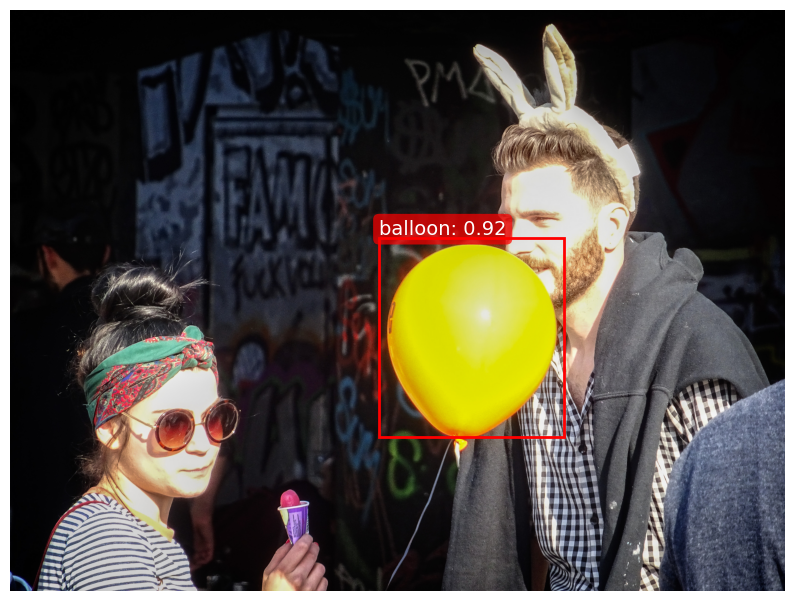

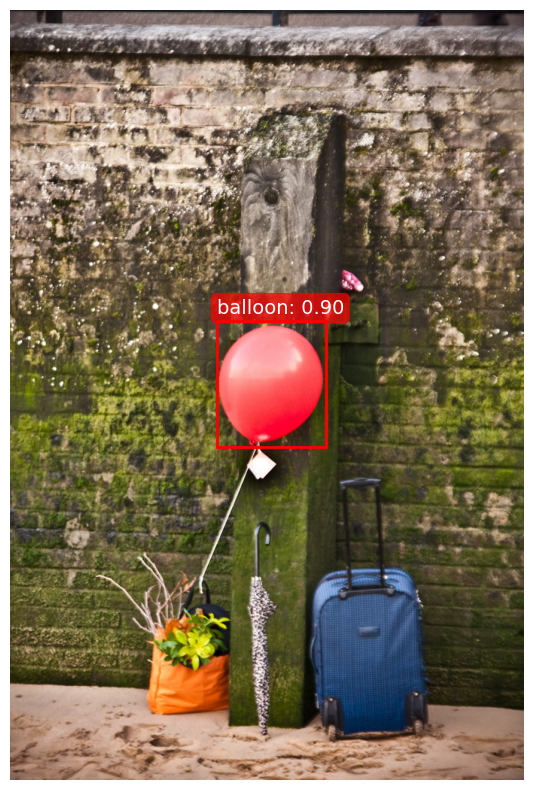

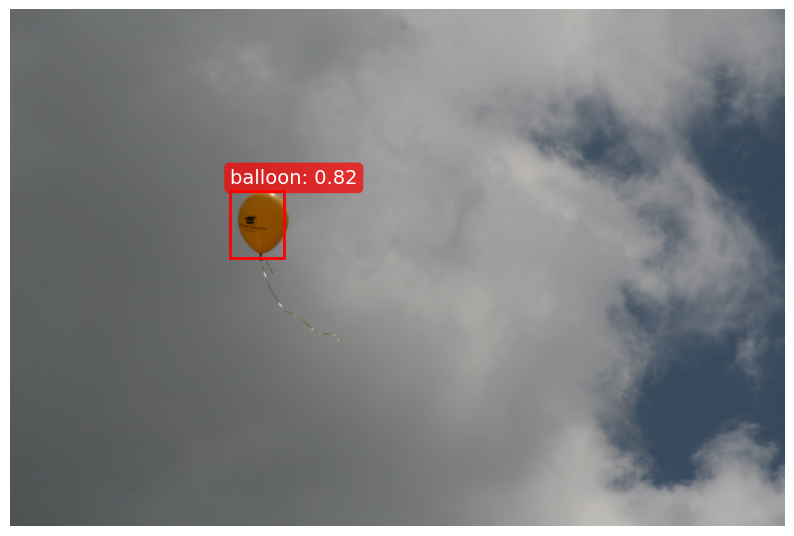

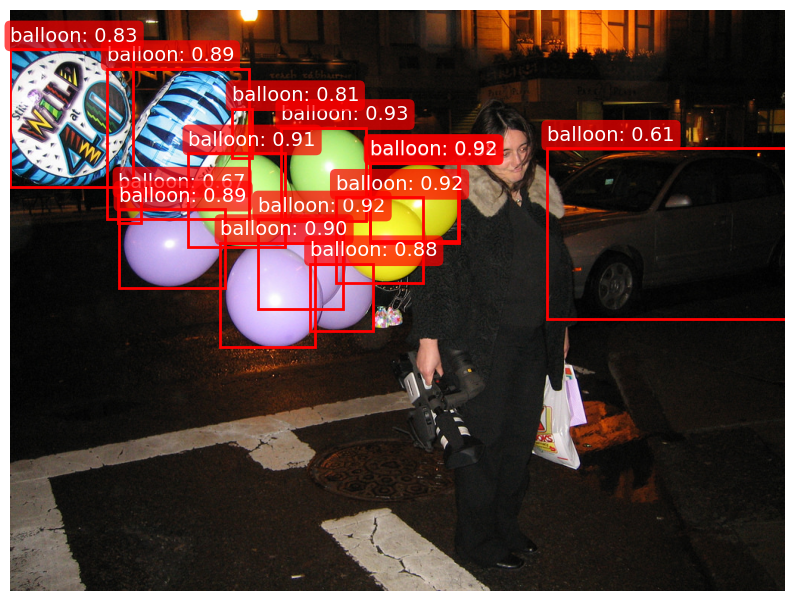

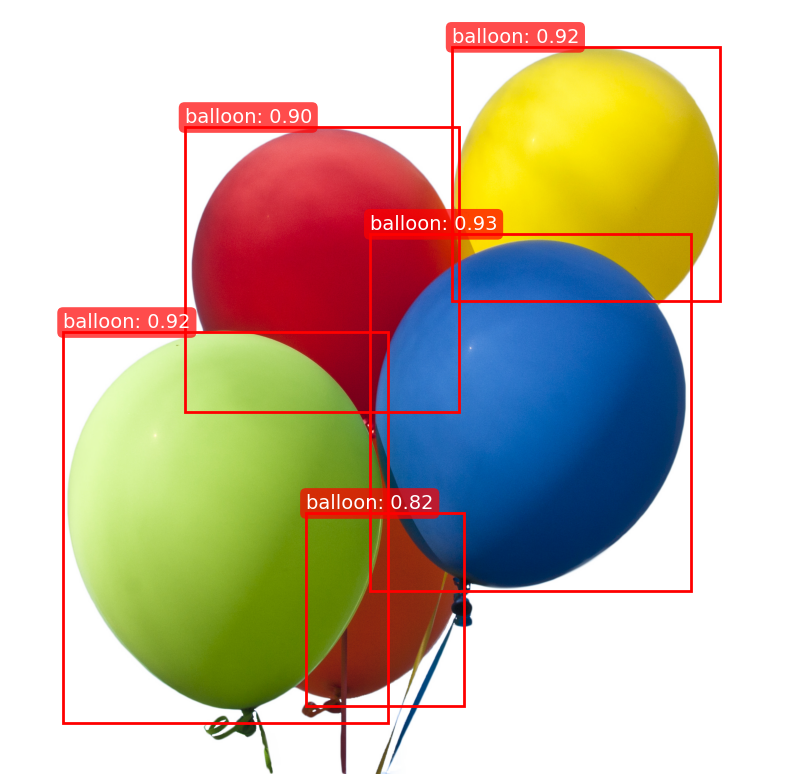

In [35]:
for i in range(5):  # Visualize 5 images
    visualize_predictions(trained_model, val_dataset, idx=i)

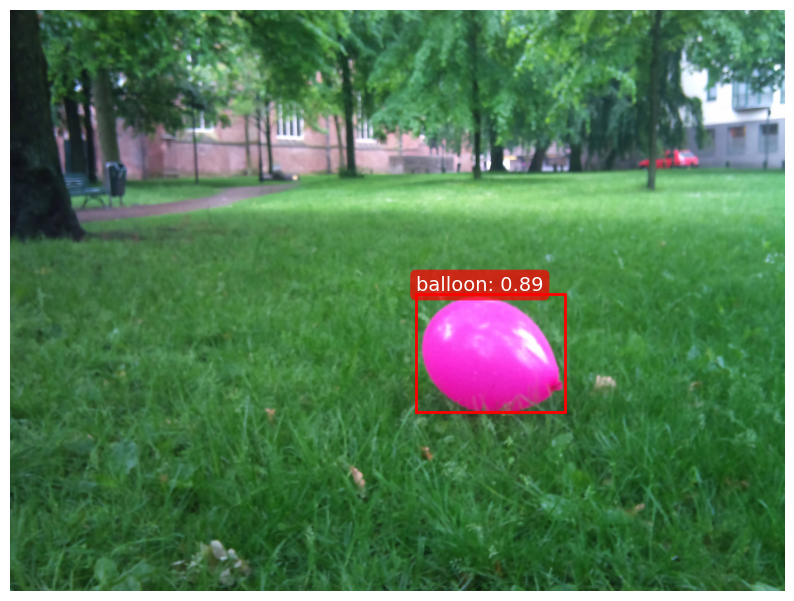

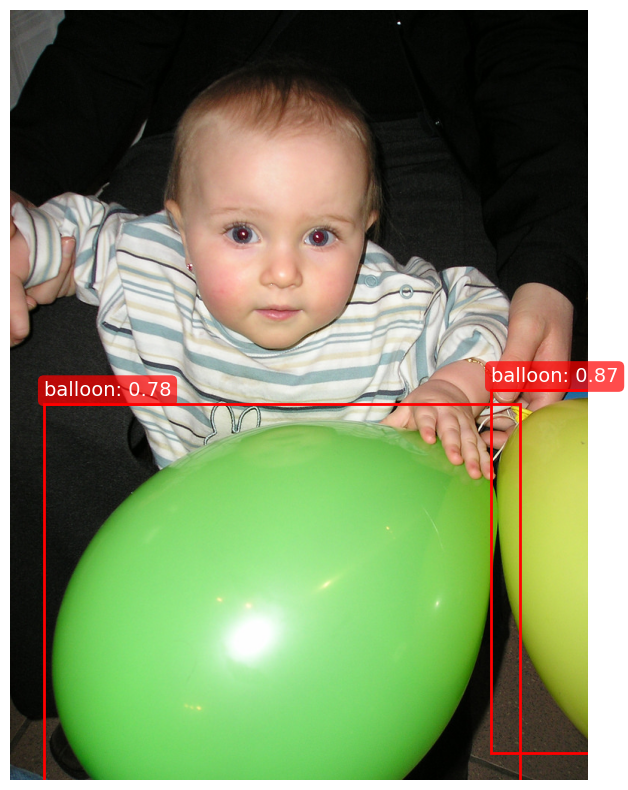

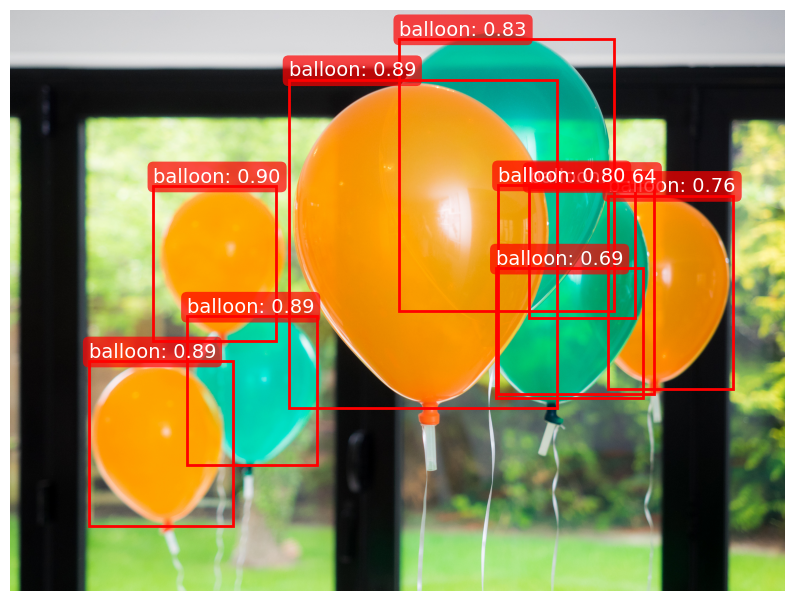

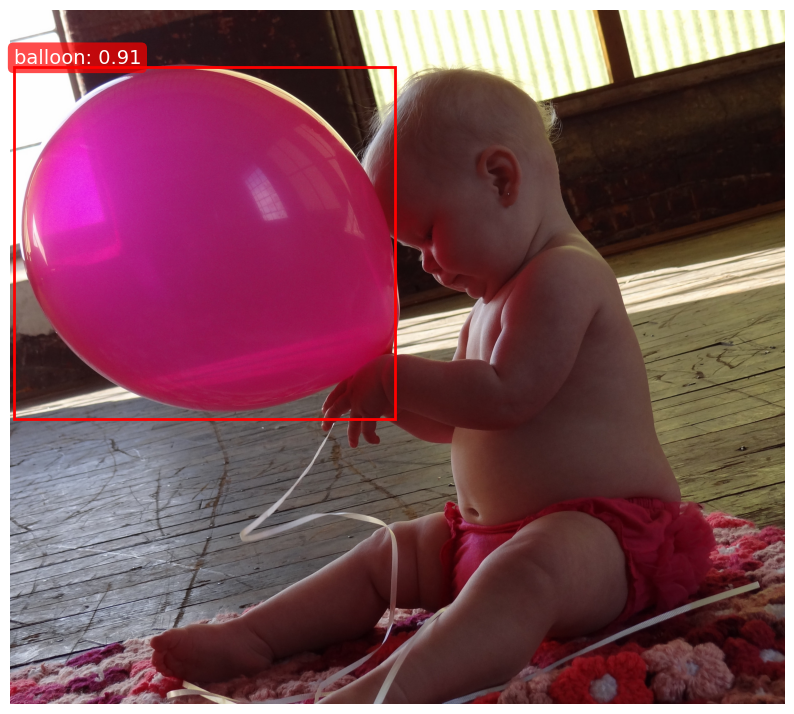

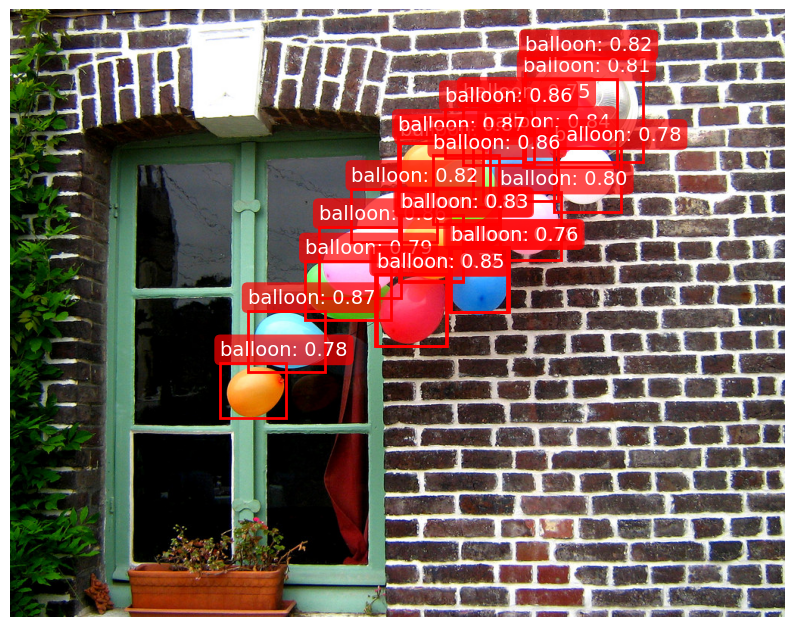

In [36]:
for i in range(5):  # Visualize 5 images
    visualize_predictions(trained_model, test_dataset, idx=i)

## Without Augmentation

In [49]:
# Create datasets without augmentation
train_dataset_no_aug = CustomCocoDataset(img_folder, train_ann_file)
train_dataloader_no_aug = DataLoader(
    train_dataset_no_aug,
    batch_size=4,
    shuffle=True,
    collate_fn=collate_fn,
    num_workers=4
)

# Initialize the model
model_no_aug = DetrModel(lr=1e-4, lr_backbone=1e-5, weight_decay=1e-4)

# Trainer
trainer_no_aug = pl.Trainer(
    max_epochs=10,
    accelerator='gpu' if torch.cuda.is_available() else 'cpu',
    devices=1 if torch.cuda.is_available() else None,
    gradient_clip_val=0.1,
    enable_progress_bar=True,
    log_every_n_steps=1,
    num_sanity_val_steps=0,
)

# Train the model
trainer_no_aug.fit(model_no_aug, train_dataloaders=train_dataloader_no_aug, val_dataloaders=val_dataloader)

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


Some weights of DetrForObjectDetection were not initialized from the model checkpoint at facebook/detr-resnet-50 and are newly initialized because the shapes did not match:
- class_labels_classifier.weight: found shape torch.Size([92, 256]) in the checkpoint and torch.Size([3, 256]) in the model instantiated
- class_labels_classifier.bias: found shape torch.Size([92]) in the checkpoint and torch.Size([3]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                   | Params | Mode
---------------------------

Training: |          | 0/? [00:00<?, ?it/s]

The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.


Validation: |          | 0/? [00:00<?, ?it/s]

The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will 

Validation: |          | 0/? [00:00<?, ?it/s]

The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.


Validation: |          | 0/? [00:00<?, ?it/s]

The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.


Validation: |          | 0/? [00:00<?, ?it/s]

The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.


Validation: |          | 0/? [00:00<?, ?it/s]

The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will 

Validation: |          | 0/? [00:00<?, ?it/s]

The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.


Validation: |          | 0/? [00:00<?, ?it/s]

The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.


Validation: |          | 0/? [00:00<?, ?it/s]

The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.


Validation: |          | 0/? [00:00<?, ?it/s]

The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.


Validation: |          | 0/? [00:00<?, ?it/s]

The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


In [50]:
def evaluate_model(model, dataset, dataloader, device):
    model.to(device)
    model.eval()
    coco_gt = dataset.coco
    coco_dt_list = []
    image_ids = []

    with torch.no_grad():
        for batch_idx, batch in enumerate(dataloader):
            pixel_values = batch["pixel_values"].to(device)
            pixel_mask = batch.get("pixel_mask", None)  # Получаем pixel_mask
            if pixel_mask is not None:
                pixel_mask = pixel_mask.to(device)

            labels = batch["labels"]

            # Передаем pixel_mask в модель
            outputs = model.model(pixel_values=pixel_values, pixel_mask=pixel_mask)

            # Obtain target sizes (height, width) from the images
            target_sizes = torch.stack([torch.tensor([t["orig_size"][0], t["orig_size"][1]]) for t in labels]).to(device)

            # Post-process results with processor
            results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=0.0)
            print(f"Batch {batch_idx}: Number of results: {len(results)}")

            for i, output in enumerate(results):
                image_id = labels[i]["image_id"].item()
                boxes = output["boxes"].cpu().numpy()
                scores = output["scores"].cpu().numpy()
                labels_pred = output["labels"].cpu().numpy()

                if len(boxes) == 0:
                    print(f"No detections for image_id {image_id}")
                    continue

                for box, score, label in zip(boxes, scores, labels_pred):
                    xmin, ymin, xmax, ymax = box
                    width = xmax - xmin
                    height = ymax - ymin
                    coco_dt_list.append({
                        "image_id": int(image_id),
                        "category_id": 1,  # 'balloon' category
                        "bbox": [float(xmin), float(ymin), float(width), float(height)],
                        "score": float(score)
                    })
                image_ids.append(int(image_id))

    print(f"Total number of detections: {len(coco_dt_list)}")

    if len(coco_dt_list) == 0:
        print("No detections were made by the model.")
        return

    # Save the detections in COCO format
    with open('detections.json', 'w') as f:
        json.dump(coco_dt_list, f)

    # Evaluate using COCO tools
    coco_dt = coco_gt.loadRes('detections.json')
    coco_eval = COCOeval(coco_gt, coco_dt, 'bbox')
    coco_eval.params.imgIds = list(set(image_ids))
    coco_eval.evaluate()
    coco_eval.accumulate()
    coco_eval.summarize()


In [51]:
evaluate_model(model_no_aug, test_dataset, test_dataloader, device)

The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.


Batch 0: Number of results: 2
Batch 1: Number of results: 2
Batch 2: Number of results: 2
Batch 3: Number of results: 2
Batch 4: Number of results: 2
Batch 5: Number of results: 2
Total number of detections: 1200
Loading and preparing results...
DONE (t=0.01s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.36s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.036
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.115
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.009
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.002
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.068
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.073
 Average Recal

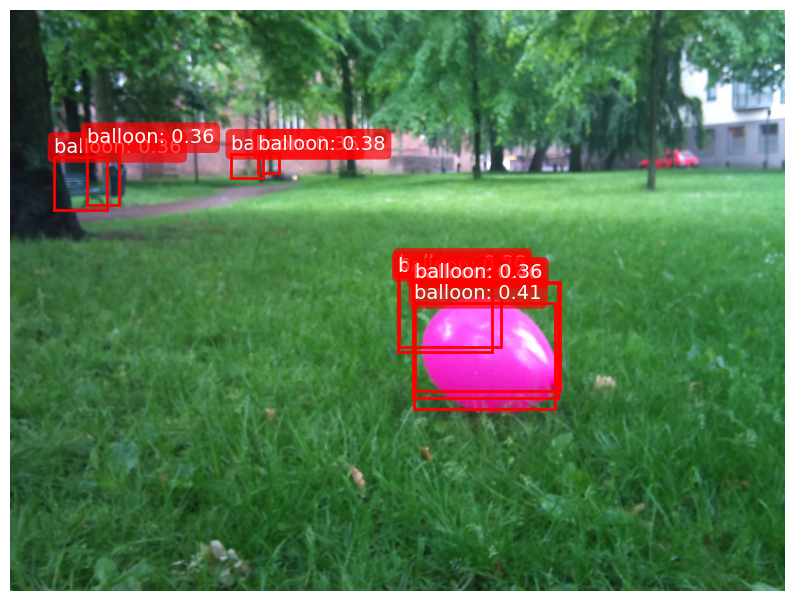

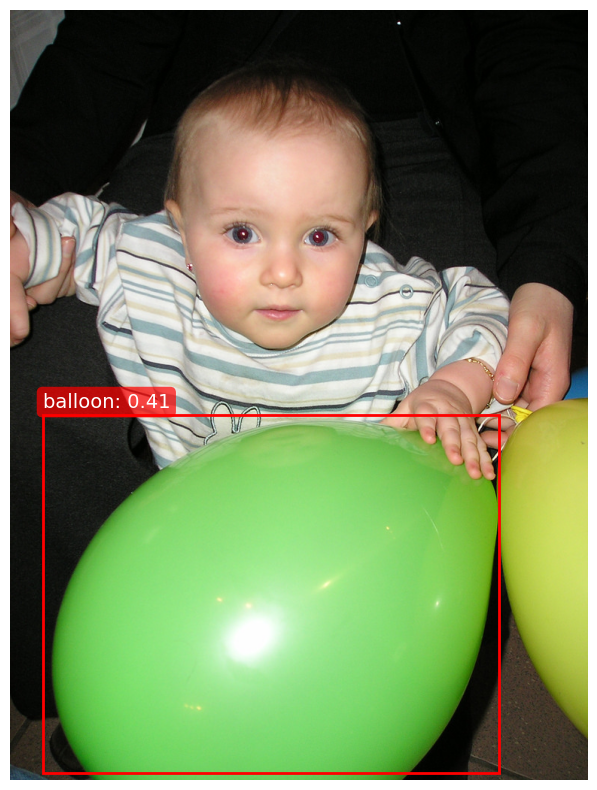

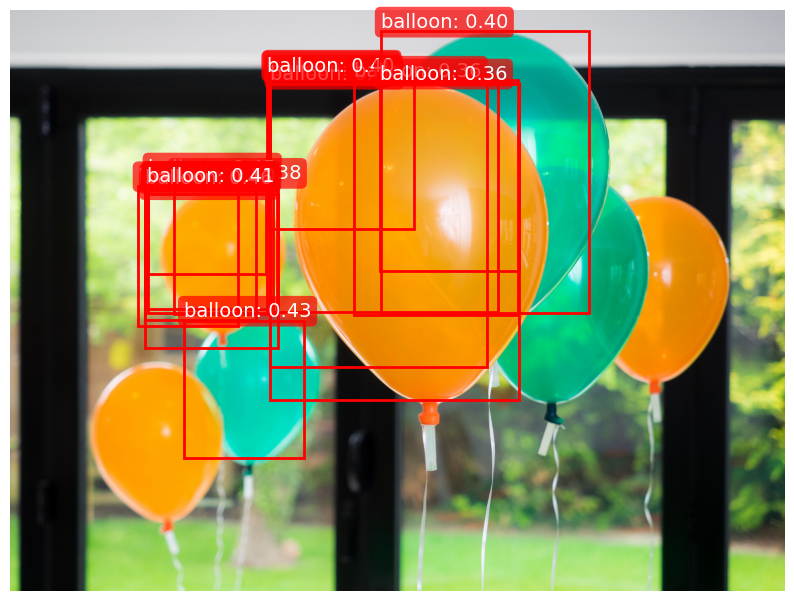

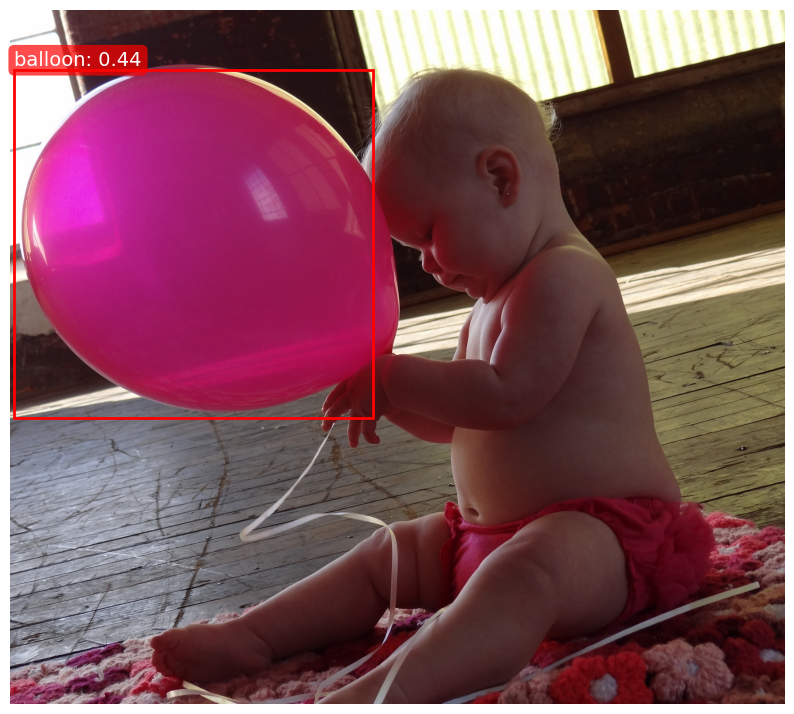

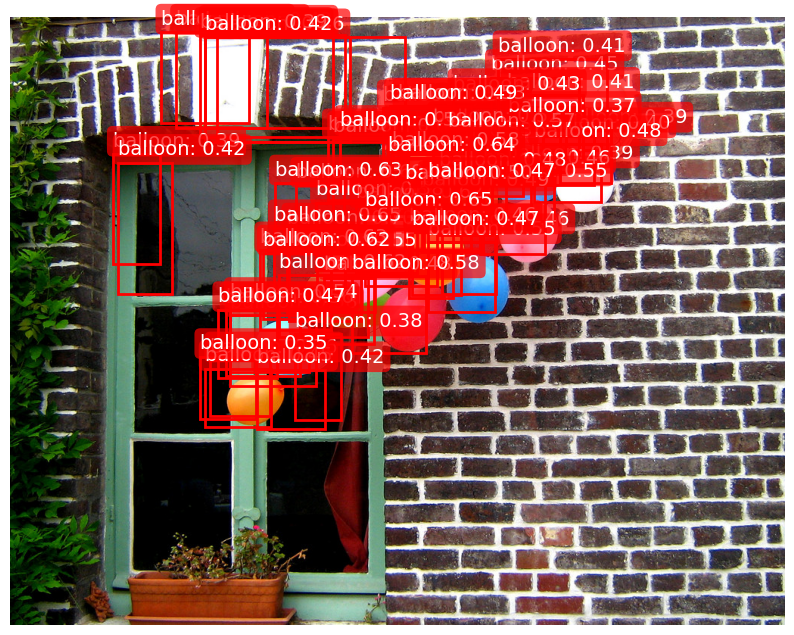

In [52]:
for i in range(5):  # Visualize 5 images
    visualize_predictions(model_no_aug, test_dataset, idx=i, threshold=0.35)

In [53]:
!zip -r /content/checkpoints.zip /content/checkpoints
!zip -r /content/lightning_logs.zip /content/lightning_logs

updating: content/checkpoints/ (stored 0%)
updating: content/checkpoints/best-checkpoint.ckpt (deflated 16%)
updating: content/lightning_logs/ (stored 0%)
updating: content/lightning_logs/detr-balloon/ (stored 0%)
updating: content/lightning_logs/detr-balloon/version_0/ (stored 0%)
updating: content/lightning_logs/detr-balloon/version_0/events.out.tfevents.1732649887.68d180023e14.567.0 (deflated 72%)
updating: content/lightning_logs/detr-balloon/version_0/hparams.yaml (deflated 9%)
updating: content/lightning_logs/version_0/ (stored 0%)
updating: content/lightning_logs/version_0/hparams.yaml (deflated 9%)
updating: content/lightning_logs/version_0/events.out.tfevents.1732650508.68d180023e14.567.1 (deflated 71%)
updating: content/lightning_logs/version_0/checkpoints/ (stored 0%)
updating: content/lightning_logs/version_0/checkpoints/epoch=9-step=130.ckpt (deflated 17%)
  adding: content/lightning_logs/version_1/ (stored 0%)
  adding: content/lightning_logs/version_1/hparams.yaml (deflat